In [1]:
import os
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from pathlib import Path
# !pip install ultralytics
from ultralytics import YOLO
import numpy as np
import matplotlib.pyplot as plt
# !pip install easyocr
import easyocr


In [ ]:
# Only characters present in Spanish license plates (no vowels)
CHAR_CLASSES = "0123456789BCDFGHJKLMNPQRSTVWXYZ"

class LicensePlateDetector:
    def __init__(self):
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model = None

    # =========================================================================
    # OCR Utility Functions (NOUS)
    # =========================================================================
    def correct_to_digit(self, char):
        """Intenta corregir caràcters amb confusió a dígits (per posicions 0-3)."""
        # Confusions habituals de lletra a número
        confusion_map = {'O': '0', 'Q': '0', 'I': '1', 'L': '1', 'S': '5', 'Z': '2', 'B': '8'}
        if char.isdigit():
            return char
        return confusion_map.get(char.upper(), char)

    def correct_to_letter(self, char):
        """Intenta corregir caràcters amb confusió a lletres (per posicions 4-6)."""
        # Confusions habituals de número a lletra
        confusion_map = {'0': 'D', '1': 'L', '5': 'S', '8': 'B', '2': 'Z'}
        if char.isalpha():
            return char
        return confusion_map.get(char, char)
    
    # =========================================================================
    # Training and Detection Functions (Es mantenen iguals)
    # =========================================================================

    def create_dataset(self, dataset_path, yaml_path="dataset.yaml"):
        """Create a file dataset.yaml for training the model"""
        train_path = os.path.join(dataset_path, 'images', 'train')
        val_path = os.path.join(dataset_path, 'images', 'val')
        test_path = os.path.join(dataset_path, 'images', 'test')

        config_content = f"""
path: {dataset_path}
train: {train_path}
val: {val_path}
test: {test_path}
names:
  0: license_plate"""
        with open(yaml_path, 'w') as file:
            file.write(config_content)
        print(f"Dataset configuration file created at {yaml_path}")
        return yaml_path

    def train_model(self, dataset_path, epochs=10, batch=8, project="license_plate_training"):
        """Train a custom model for license plate detection."""
        yaml_path = self.create_dataset(dataset_path)
        print("Starting training...")
        # Load base model
        self.model = YOLO("yolov8n.pt")
        # Train the model on the custom dataset
        results = self.model.train(data=yaml_path, epochs=epochs, batch=batch, project=project)
        best_model_path = Path(results.save_dir) / "weights" / "best.pt"
        print("Training completed")
        print(f"Best model saved at: {str(best_model_path)}")
        return str(best_model_path)

    def detect_license_plate(self, best_model_path, test_dir, output_dir, conf=0.25):
        """Detect license plates in images using the trained model."""
        self.model = YOLO(best_model_path)
        print(f"Detecting license plates with model {best_model_path}")
        prediction_results = self.model.predict(source=test_dir, save=False, conf=conf)
        results_dir = os.path.join(output_dir, "results")
        os.makedirs(results_dir, exist_ok=True)
        for i, result in enumerate(prediction_results):
            annotated_image = result.plot()
            output_path = os.path.join(results_dir, f"detected_{i}.jpg")
            cv2.imwrite(output_path, annotated_image)
        print("Detection completed. Results saved.")
        return prediction_results

    # =========================================================================
    # Character Segmentation Functions (Es mantenen iguals per a visualització)
    # =========================================================================
        
    def preprocess_plate_for_segmentation(self, plate_image):
        """
        Preprocesses a license plate image for character segmentation.
        - Uses the V channel (Value/Brightness) of HSV for maximum contrast.
        - Applies Otsu's thresholding for automatic binarization.
        """
        # 1. Converteix a HSV (Hue, Saturation, Value)
        hsv = cv2.cvtColor(plate_image, cv2.COLOR_BGR2HSV)
        # Separació de canals: només ens interessa el canal V (Brillantor/Contrast)
        _, _, image_v = cv2.split(hsv)
        
        # 2. Suavitzat Gaussà per reduir el soroll abans de binaritzar
        image_v = cv2.GaussianBlur(image_v, (5, 5), 0)
        
        # 3. 🎯 Aplicació del Llindar d'Otsu al canal V
        # Otsu tria automàticament el millor llindar, és robust.
        # THRESH_BINARY_INV: Invertit per tenir caràcters blancs sobre fons negre
        _, binary = cv2.threshold(image_v, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        
        # 4. Operacions Morfològiques per netejar
        kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
        # CLOSING: omple petits forats dins dels caràcters
        binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel, iterations=2)
        # OPENING: elimina el soroll petit
        binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=1)
                
        return binary

    def segment_characters(self, plate_image):
        """Finds and segments individual characters (usat principalment per a dibuixar les caixes)."""
        preprocessed_plate = self.preprocess_plate_for_segmentation(plate_image)        
        contours, _ = cv2.findContours(preprocessed_plate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        characters = []
        plate_height, plate_width = preprocessed_plate.shape
        
        for contour in contours:
            x, y, w, h = cv2.boundingRect(contour)
            aspect_ratio = w / h
            area = cv2.contourArea(contour)

            touches_border = (x==0 or y==0 or (x+w) >= plate_width or (y+h) >= plate_height)
            
            if area > 50 and 0.1 < aspect_ratio < 1.2 and h > 10 and w > 3 and not touches_border:
                character_roi = plate_image[y:y+h, x:x+w]
                characters.append({'image': character_roi, 'bbox': (x, y, w, h)})
        
        characters.sort(key=lambda c: c['bbox'][0])

        if len(characters) > 7:
            characters = sorted(characters, key=lambda c: c['bbox'][2]*c['bbox'][3], reverse=True)[:7]
            characters.sort(key=lambda c: c['bbox'][0])

        return characters, preprocessed_plate

    def process_and_show_results(self, prediction_results, reader):
        """
        Processes each detected plate.
        MODIFICACIÓ: Implementa la lògica de EasyOCR amb ordenació espacial i cerca intel·ligent.
        """
        for i, result in enumerate(prediction_results):
            image = result.orig_img
            boxes = result.boxes
            
            if boxes:
                print(f"\n--- Processing Image {i+1} ---")
                
                for j, box in enumerate(boxes):
                    x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                    plate_image = image[y1:y2, x1:x2]
                    
                    if plate_image is not None and plate_image.size > 0:
                        print(f"Detected License Plate {j+1}: Bbox {x1, y1, x2, y2}")
                        
                        characters, preprocessed_plate = self.segment_characters(plate_image)
                        print(f"Found {len(characters)} character candidates.")

                        # 1. OCR amb EasyOCR amb detall (detail=1) per obtenir els bounding boxes
                        # Ús d'allowlist per restringir a caràcters de matrícula.
                        ocr_raw = reader.readtext(plate_image, detail=1, paragraph=False, allowlist=CHAR_CLASSES)
                        
                        # 2. Ordenem els resultats per la coordenada X inicial (x1)
                        # Això garanteix l'ordre d'esquerra a dreta.
                        sorted_ocr = sorted(ocr_raw, key=lambda item: item[0][0][0])
                        
                        # 3. Concatenem el text en l'ordre espacial correcte
                        plate_text_raw = "".join([item[1] for item in sorted_ocr]).replace(" ", "").upper()
                        
                        # 4. Neteja de caràcters no vàlids
                        filtered = "".join([c for c in plate_text_raw if c in CHAR_CLASSES])
                        
                        if filtered.startswith("E"):
                            filtered = filtered[1:]  # Elimina 'E' inicial (bandera UE)
                        
                        plate_text = filtered # Valor per defecte
                        
                        # 🎯 5. APLICACIÓ DE LA LÒGICA DE FILTRAT I CORRECCIÓ INTEL·LIGENT (FINDOSTRA LLISCANT)
                        
                        best_plate = ""
                        max_score = -1
                        
                        if len(filtered) >= 7:
                            # Iterem per totes les finestres de 7 caràcters possibles
                            for start_idx in range(len(filtered) - 6):
                                current_segment = filtered[start_idx : start_idx + 7]
                                current_score = 0
                                
                                # Calculem la puntuació: quants caràcters coincideixen amb el patró 4+3
                                for k, char in enumerate(current_segment):
                                    is_digit = char.isdigit()
                                    is_letter = char.isalpha()
                                    
                                    if k < 4 and is_digit: # Puntuem coincidència amb DÍGIT
                                        current_score += 1
                                    elif k >= 4 and is_letter: # Puntuem coincidència amb LLETRA
                                        current_score += 1
                                        
                                # Trobem la seqüència amb més coincidències
                                if current_score > max_score:
                                    max_score = current_score
                                    best_plate = current_segment
                                    
                            # Si hem trobat una seqüència de 7, apliquem les correccions
                            if best_plate:
                                final_placa = []
                                for k, char in enumerate(best_plate):
                                    if k < 4:
                                        final_placa.append(self.correct_to_digit(char))
                                    else:
                                        final_placa.append(self.correct_to_letter(char))
                                
                                plate_text = "".join(final_placa)
                                
                                # Formatació final (0000 LLL)
                                if len(plate_text) == 7:
                                    plate_text = plate_text[:4] + " " + plate_text[4:]
                            
                        print(f"OCR Result, Detected Plate: {plate_text}")

                        # Visualize results
                        output_image = plate_image.copy()
                        for char_info in characters:
                            x, y, w, h = char_info['bbox']
                            cv2.rectangle(output_image, (x, y), (x + w, y + h), (0, 255, 0), 2)
                        
                        cv2.putText(image, plate_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                        
                        annotated_full_image = result.plot()
                        
                        plt.figure(figsize=(20, 5))
                        
                        plt.subplot(1, 4, 1)
                        plt.imshow(cv2.cvtColor(annotated_full_image, cv2.COLOR_BGR2RGB))
                        plt.title("Licensed Plate Detection")
                        plt.axis('off')
                        
                        plt.subplot(1, 4, 2)
                        plt.imshow(cv2.cvtColor(plate_image, cv2.COLOR_BGR2RGB))
                        plt.title("Cropped License Plate")
                        plt.axis('off')
                        
                        plt.subplot(1, 4, 3)
                        plt.imshow(preprocessed_plate, cmap='gray')
                        plt.title("Image Preprocessed (Binarized)")
                        plt.axis('off')
                        
                        plt.subplot(1, 4, 4)
                        plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
                        plt.title(f"Characters Segmented: {len(characters)}")
                        plt.axis('off')
                        
                        plt.suptitle(f"Image {i+1} | OCR: {plate_text}")
                        plt.tight_layout()
                        plt.show()

                    else:
                        print("Could not crop license plate. Skipping.")
            else:
                print(f"\n--- Processing Image {i+1} ---")
                print("No license plate detected in this image.")

In [47]:
#* ================= MAIN EXECUTION =================

# dataset_path = "/content/BD/BD_LicensePlate"
# test_dir = "/content/BD/BD_LicensePlate/images/test"
# output_dir = "/content/test_results"

dataset_path = r"C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate"
test_dir = r"C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test"
output_dir = r"C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\test_results"

detector = LicensePlateDetector()
reader = easyocr.Reader(['en'])

# best_model_path = detector.train_model(dataset_path, epochs=10, batch=8)
best_model_path = r"C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\models\best_license_plate.pt"
# best_model_path = r"C:\Users\adria\OneDrive - UAB\4 ENGINY\Processament Imatge i Video\Repte Matriculas\License-Plate-Detection\models\best.pt"
prediction_results = detector.detect_license_plate(best_model_path, test_dir, output_dir, conf=0.25)

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


Detecting license plates with model C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\models\best_license_plate.pt

image 1/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test\Image .png: 608x640 1 license_plate, 121.0ms
image 2/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test\PXL_20210921_094926329.jpg: 384x640 1 license_plate, 86.4ms
image 3/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test\PXL_20210921_094938026.jpg: 384x640 1 license_plate, 56.6ms
image 4/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test\PXL_20210921_094946132.jpg: 384x640 1 license_plate, 62.4ms
image 5/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\images\test\PXL_20210921_094951899.jpg: 384x640 1 license_plate, 54.7ms
image 6/49 C:\Users\PC\OneDrive\Escriptori\UNI\4t\MA PSIV\BD_LicensePlate\BD_LicensePlate\im


--- Processing Image 1 ---
Detected License Plate 1: Bbox (60, 487, 362, 669)
Found 7 character candidates.
OCR Result, Detected Plate: 1368 DRH


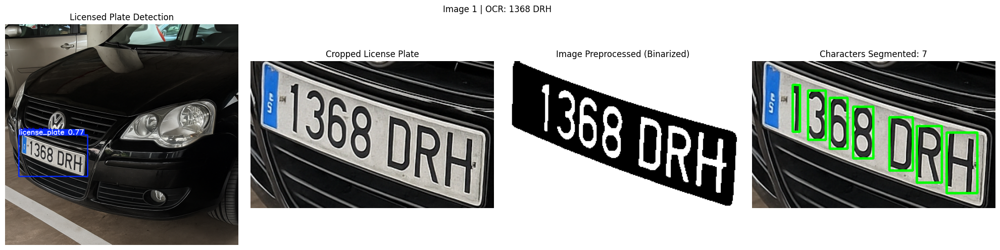


--- Processing Image 2 ---
Detected License Plate 1: Bbox (871, 1057, 1699, 1424)
Found 7 character candidates.
OCR Result, Detected Plate: 5796 DKP


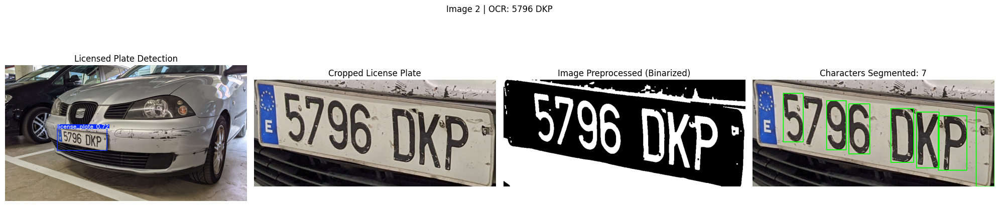


--- Processing Image 3 ---
Detected License Plate 1: Bbox (1009, 870, 1763, 1223)
Found 7 character candidates.
OCR Result, Detected Plate: 1556 GMZ


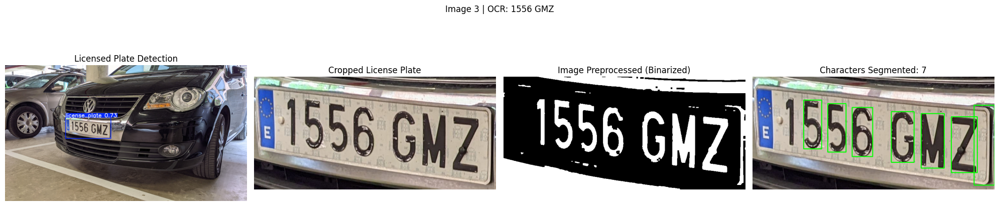


--- Processing Image 4 ---
Detected License Plate 1: Bbox (1074, 955, 1960, 1289)
Found 7 character candidates.
OCR Result, Detected Plate: 0182 GLK


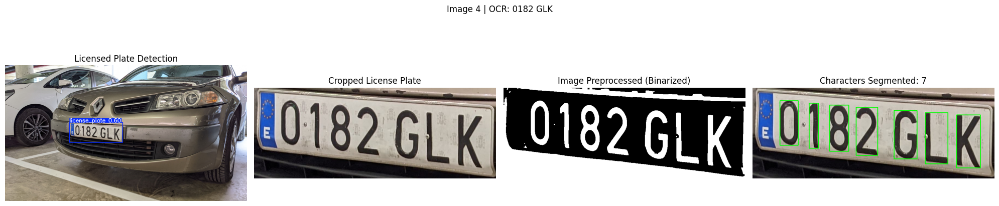


--- Processing Image 5 ---
Detected License Plate 1: Bbox (1196, 709, 2004, 1032)
Found 7 character candidates.
OCR Result, Detected Plate: 8044 JMB


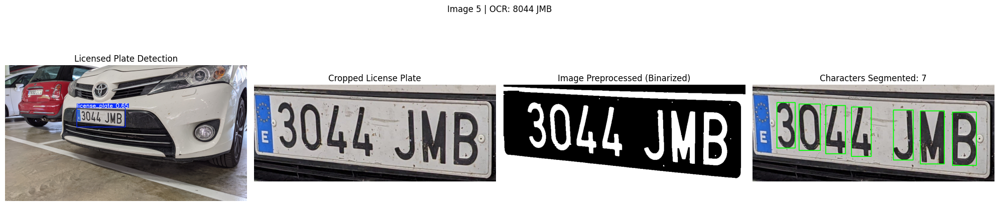


--- Processing Image 6 ---
Detected License Plate 1: Bbox (1099, 927, 1914, 1284)
Found 7 character candidates.
OCR Result, Detected Plate: 5789 JHB


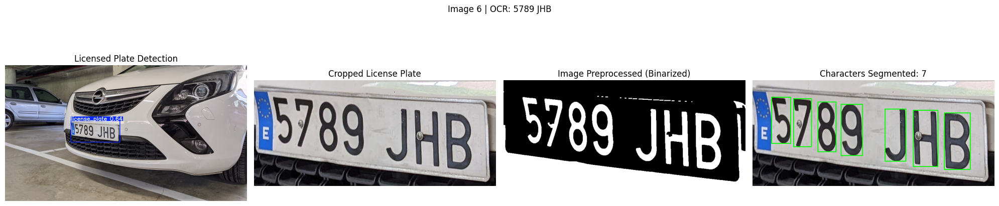


--- Processing Image 7 ---
Detected License Plate 1: Bbox (521, 821, 1450, 1183)
Found 7 character candidates.
OCR Result, Detected Plate: 6929 LKK


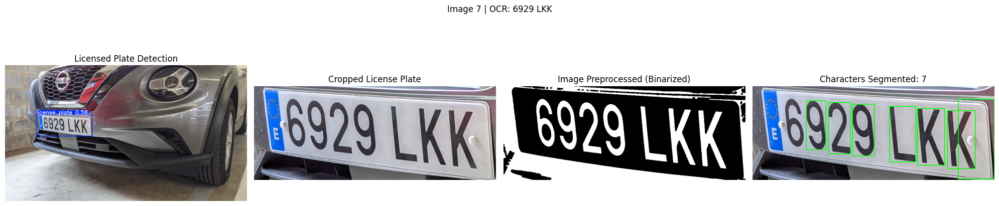


--- Processing Image 8 ---
Detected License Plate 1: Bbox (856, 970, 1905, 1339)
Found 7 character candidates.
OCR Result, Detected Plate: 3660 CRT


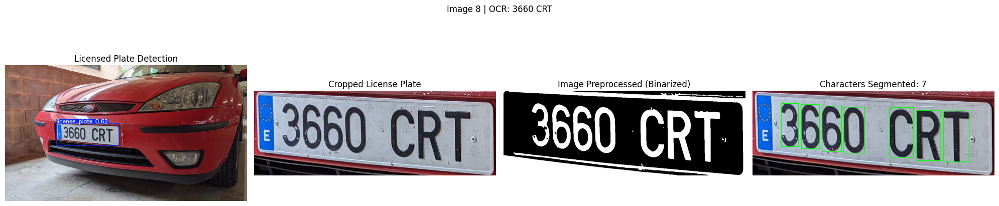


--- Processing Image 9 ---
Detected License Plate 1: Bbox (580, 1069, 1658, 1457)
Found 7 character candidates.
OCR Result, Detected Plate: 6000 GVT


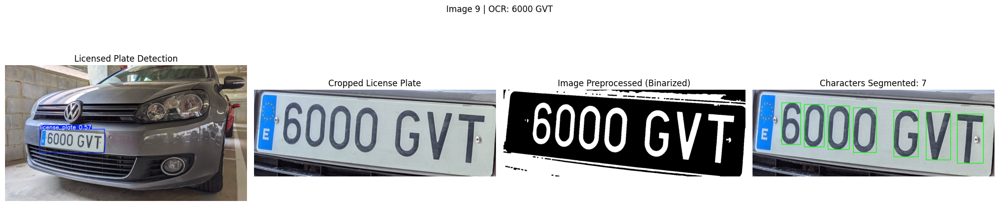


--- Processing Image 10 ---
Detected License Plate 1: Bbox (928, 764, 1898, 1161)
Found 7 character candidates.
OCR Result, Detected Plate: 3587 DCY


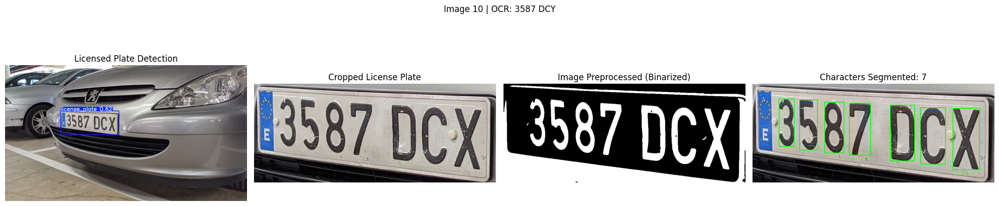


--- Processing Image 11 ---
Detected License Plate 1: Bbox (832, 1023, 1721, 1389)
Found 7 character candidates.
OCR Result, Detected Plate: 1498 JBZ


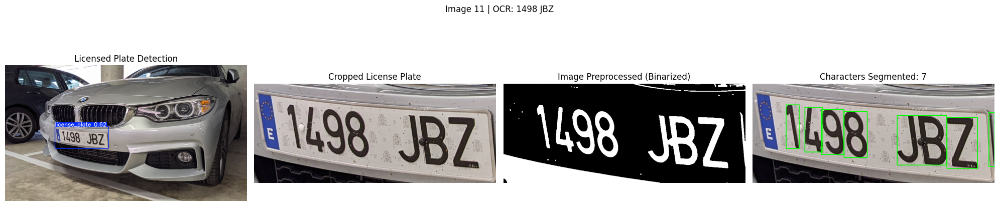


--- Processing Image 12 ---
Detected License Plate 1: Bbox (1204, 851, 2027, 1146)
Found 7 character candidates.
OCR Result, Detected Plate: 2344 KJP


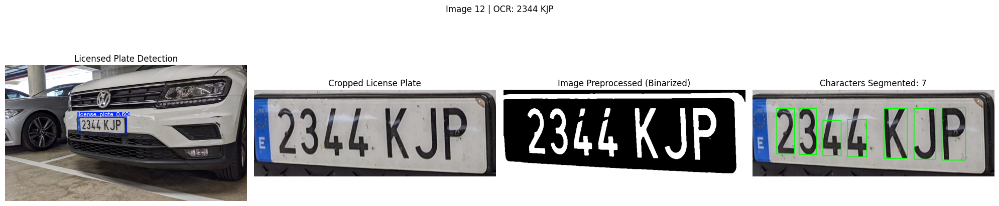


--- Processing Image 13 ---
Detected License Plate 1: Bbox (893, 1212, 1907, 1660)
Found 7 character candidates.
OCR Result, Detected Plate: 0907 JRF


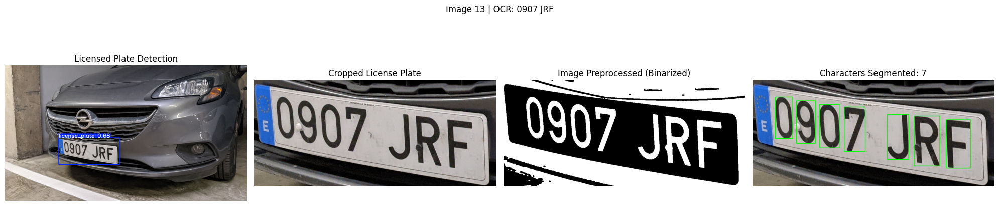


--- Processing Image 14 ---
Detected License Plate 1: Bbox (607, 847, 1605, 1212)
Found 7 character candidates.
OCR Result, Detected Plate: 6554 BNX


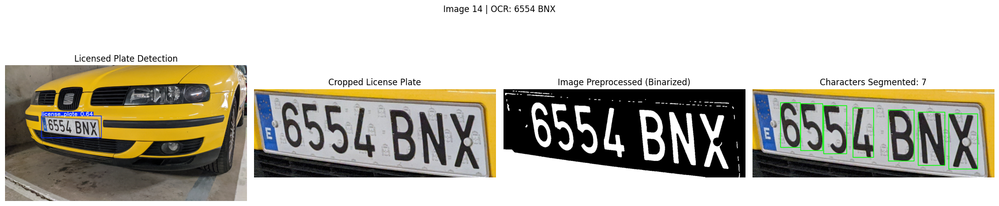


--- Processing Image 15 ---
Detected License Plate 1: Bbox (518, 1120, 1480, 1533)
Found 0 character candidates.
OCR Result, Detected Plate: 6401 JBX


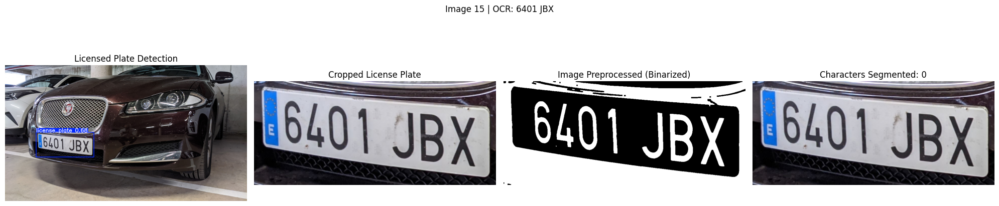


--- Processing Image 16 ---
Detected License Plate 1: Bbox (1223, 1074, 1997, 1399)
Found 7 character candidates.
OCR Result, Detected Plate: 8727 JTC


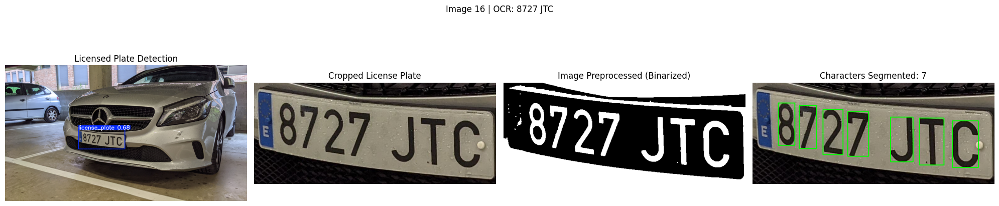


--- Processing Image 17 ---
Detected License Plate 1: Bbox (833, 981, 1728, 1223)
Found 7 character candidates.
OCR Result, Detected Plate: 5275 HGY


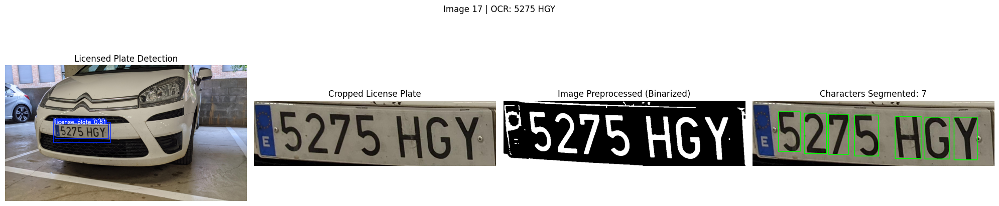

Detected License Plate 2: Bbox (806, 960, 1760, 1290)
Found 7 character candidates.
OCR Result, Detected Plate: 5275 HGY


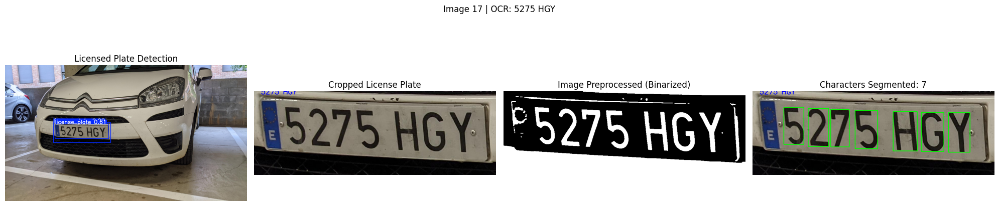


--- Processing Image 18 ---
Detected License Plate 1: Bbox (337, 258, 453, 312)
Found 3 character candidates.
OCR Result, Detected Plate: 8954 LVD


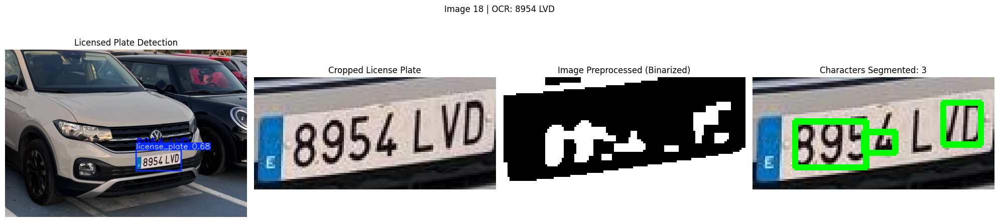


--- Processing Image 19 ---
Detected License Plate 1: Bbox (1393, 849, 2214, 1100)
Found 7 character candidates.
OCR Result, Detected Plate: F467 LFH


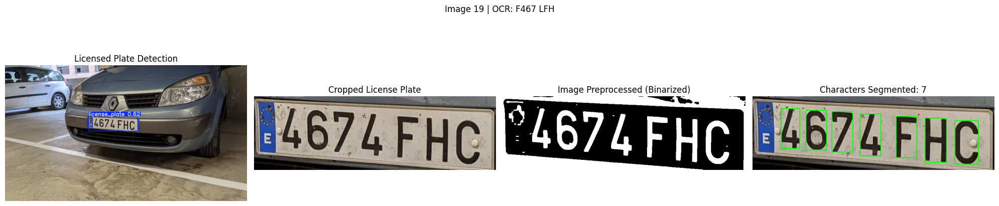


--- Processing Image 20 ---
Detected License Plate 1: Bbox (451, 548, 815, 709)
Found 7 character candidates.
OCR Result, Detected Plate: 1258 GBP


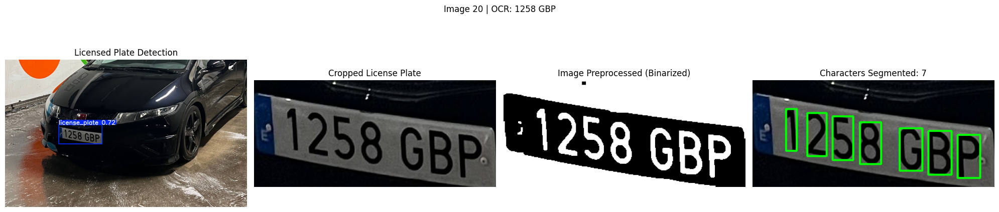


--- Processing Image 21 ---
Detected License Plate 1: Bbox (883, 426, 1180, 593)
Found 0 character candidates.
OCR Result, Detected Plate: 1258 GBP


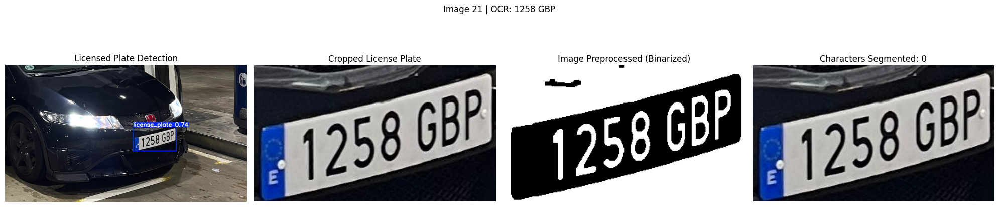


--- Processing Image 22 ---
Detected License Plate 1: Bbox (276, 206, 613, 351)
Found 7 character candidates.
OCR Result, Detected Plate: 1258 GBP


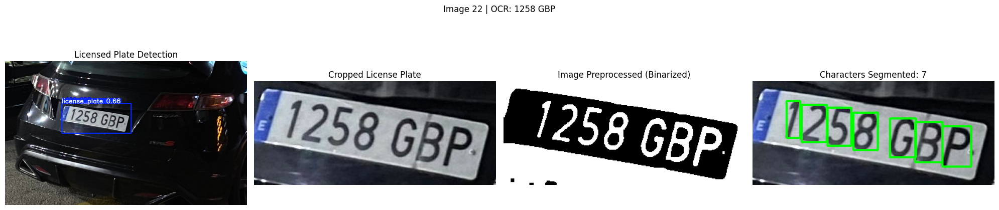


--- Processing Image 23 ---
Detected License Plate 1: Bbox (335, 763, 911, 890)
Found 7 character candidates.
OCR Result, Detected Plate: 8772 KDR


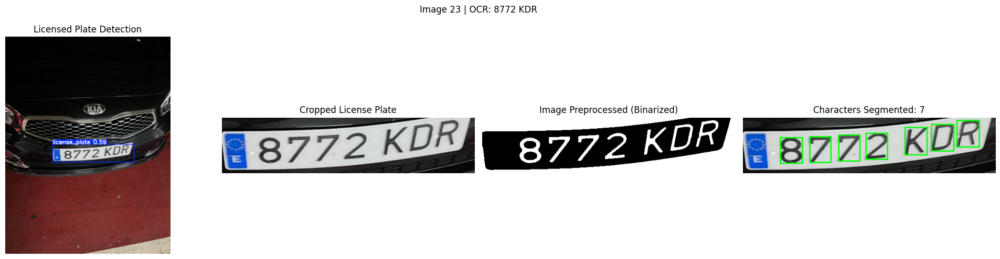


--- Processing Image 24 ---
Detected License Plate 1: Bbox (390, 786, 916, 986)
Found 7 character candidates.
OCR Result, Detected Plate: 8733 MKB


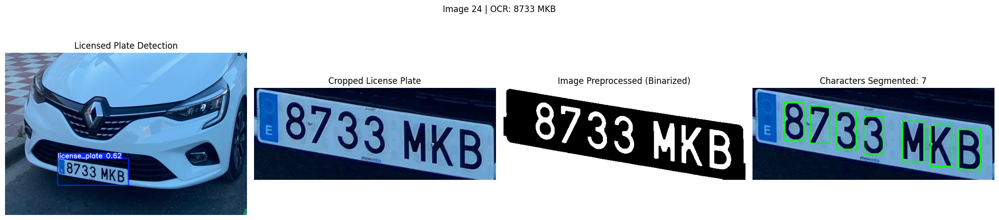


--- Processing Image 25 ---
Detected License Plate 1: Bbox (647, 217, 861, 296)
Found 7 character candidates.
OCR Result, Detected Plate: 8958 NBC


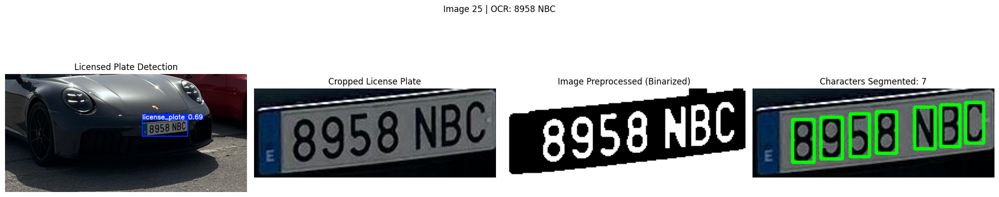


--- Processing Image 26 ---
Detected License Plate 1: Bbox (1067, 417, 1198, 558)
Found 7 character candidates.
OCR Result, Detected Plate: L29W


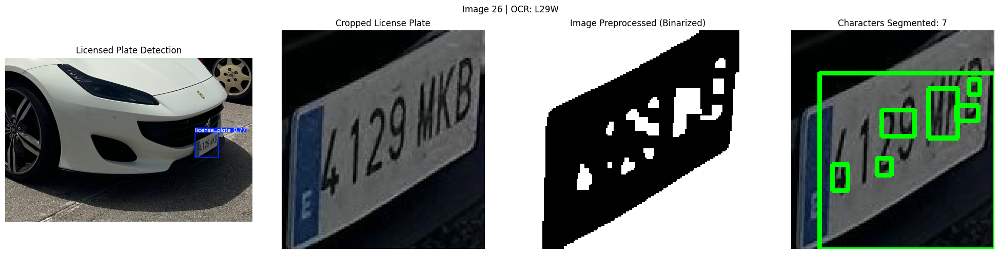


--- Processing Image 27 ---
Detected License Plate 1: Bbox (262, 0, 385, 134)
Found 7 character candidates.
OCR Result, Detected Plate: LB


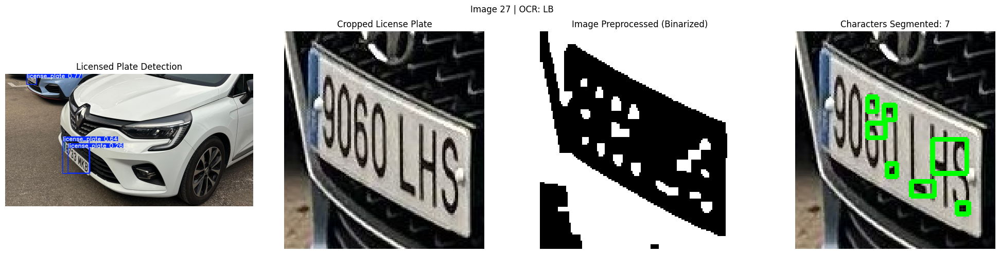

Detected License Plate 2: Bbox (701, 826, 1024, 1223)
Found 7 character candidates.
OCR Result, Detected Plate: 8733NV


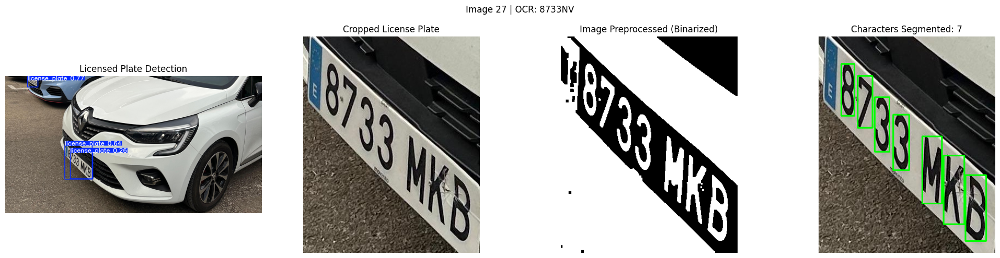

Detected License Plate 3: Bbox (766, 909, 1031, 1218)
Found 7 character candidates.
OCR Result, Detected Plate: 13YNV


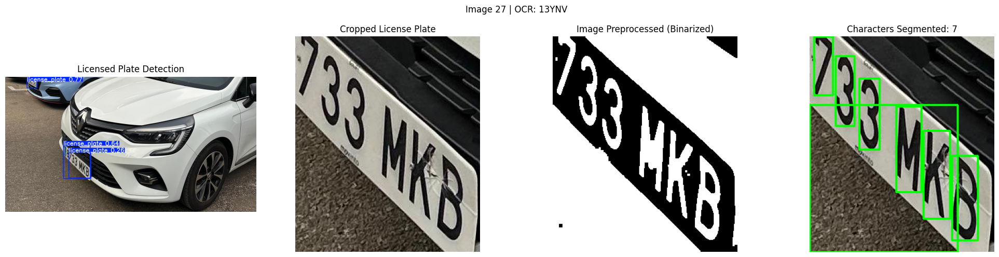


--- Processing Image 28 ---
Detected License Plate 1: Bbox (292, 465, 470, 590)
Found 4 character candidates.
OCR Result, Detected Plate: 5555 HRT


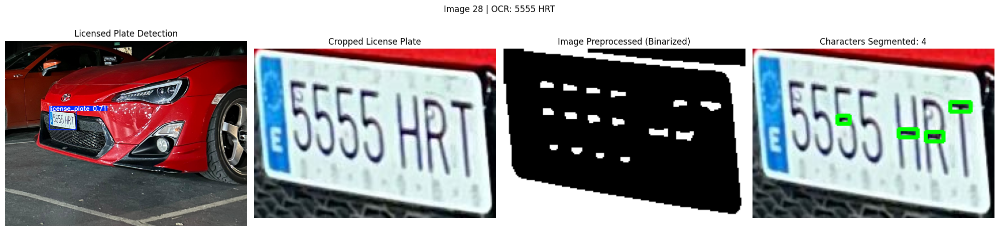


--- Processing Image 29 ---
Detected License Plate 1: Bbox (290, 606, 558, 762)
Found 7 character candidates.
OCR Result, Detected Plate: 3384 KHL


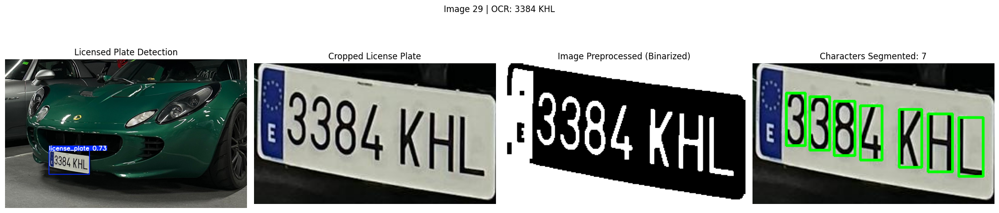


--- Processing Image 30 ---
Detected License Plate 1: Bbox (786, 399, 1106, 566)
Found 0 character candidates.
OCR Result, Detected Plate: 8661 CHH


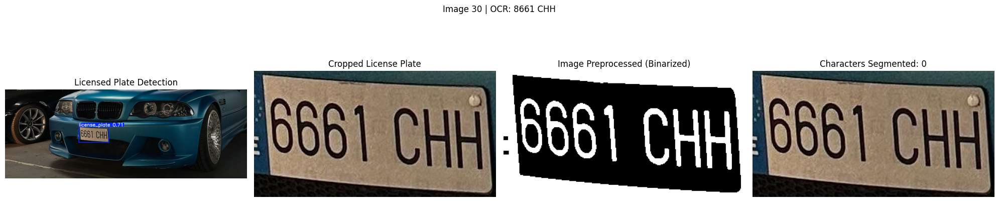


--- Processing Image 31 ---
Detected License Plate 1: Bbox (1355, 569, 1651, 804)
Found 7 character candidates.
OCR Result, Detected Plate: 6200 CVH


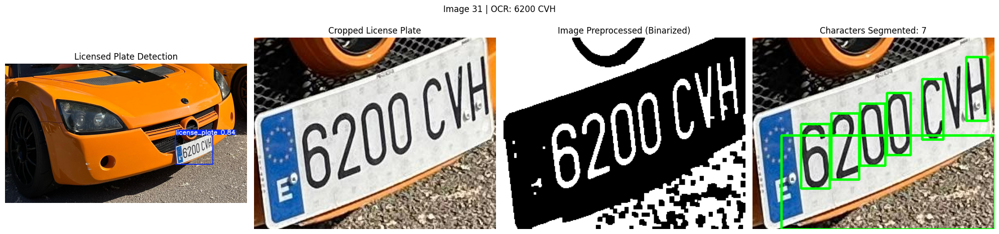


--- Processing Image 32 ---
Detected License Plate 1: Bbox (736, 491, 1210, 643)
Found 7 character candidates.
OCR Result, Detected Plate: 0215 JSG


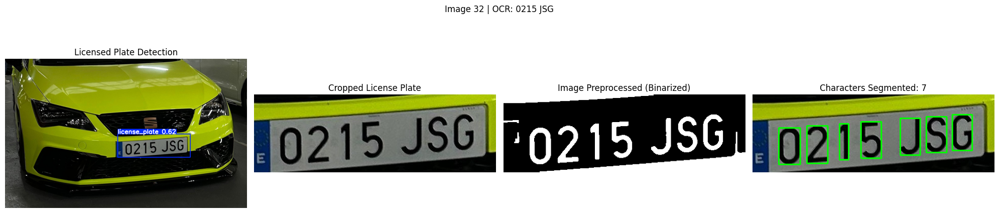


--- Processing Image 33 ---
Detected License Plate 1: Bbox (1628, 696, 1966, 934)
Found 7 character candidates.
OCR Result, Detected Plate: 1190 LGC


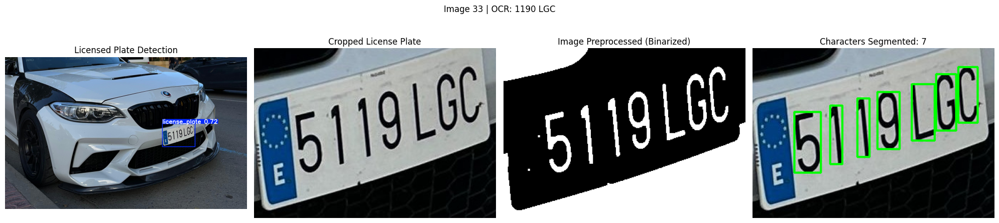


--- Processing Image 34 ---
Detected License Plate 1: Bbox (1356, 533, 1590, 691)
Found 7 character candidates.
OCR Result, Detected Plate: 7314 DHP


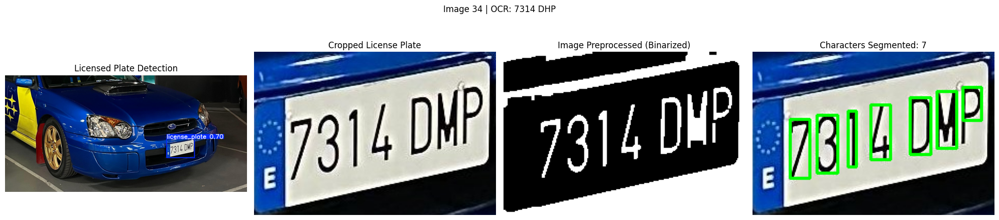


--- Processing Image 35 ---
Detected License Plate 1: Bbox (599, 884, 978, 1099)
Found 0 character candidates.
OCR Result, Detected Plate: 8901 FNP


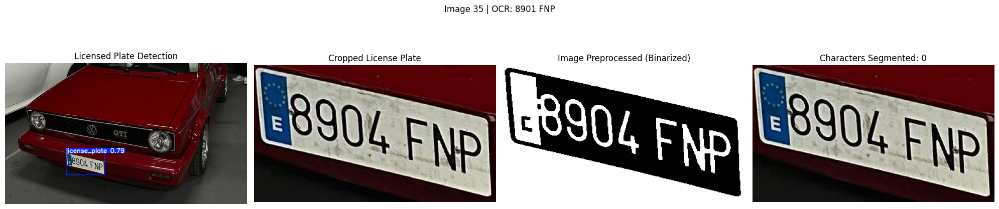


--- Processing Image 36 ---
Detected License Plate 1: Bbox (1691, 516, 1976, 710)
Found 7 character candidates.
OCR Result, Detected Plate: 2606 HHR


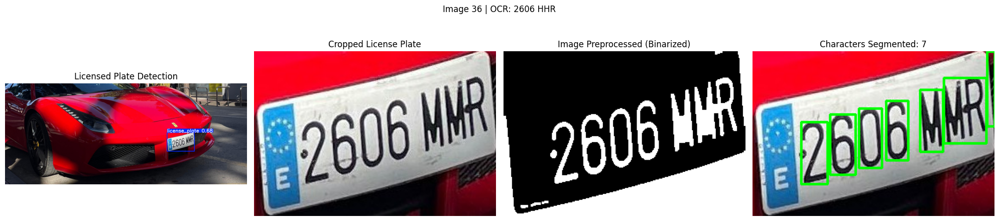


--- Processing Image 37 ---
Detected License Plate 1: Bbox (1408, 449, 1793, 622)
Found 0 character candidates.
OCR Result, Detected Plate: 4971 KKK


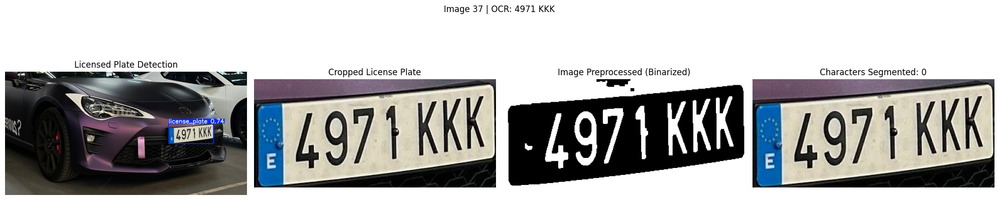


--- Processing Image 38 ---
Detected License Plate 1: Bbox (1642, 519, 2070, 718)
Found 7 character candidates.
OCR Result, Detected Plate: 0360 KDR


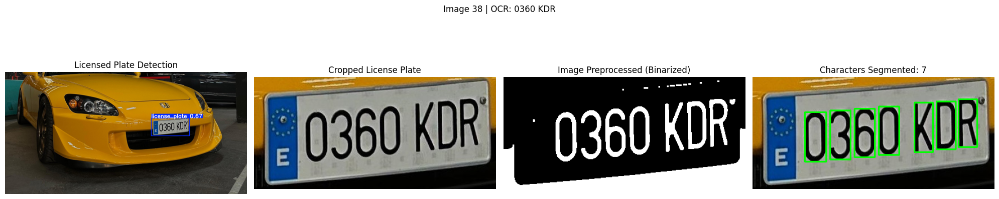


--- Processing Image 39 ---
Detected License Plate 1: Bbox (1389, 927, 1999, 1199)
Found 7 character candidates.
OCR Result, Detected Plate: 2387 KJW


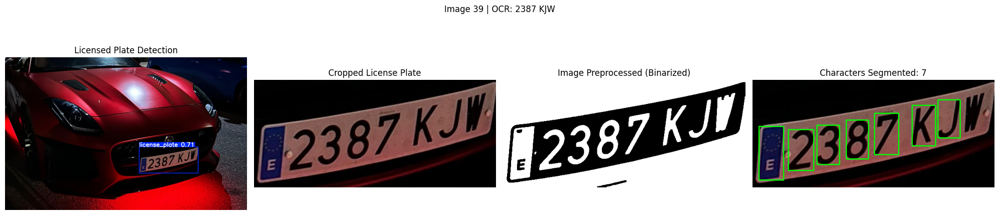


--- Processing Image 40 ---
Detected License Plate 1: Bbox (1253, 767, 1593, 980)
Found 7 character candidates.
OCR Result, Detected Plate: 8340 MNS


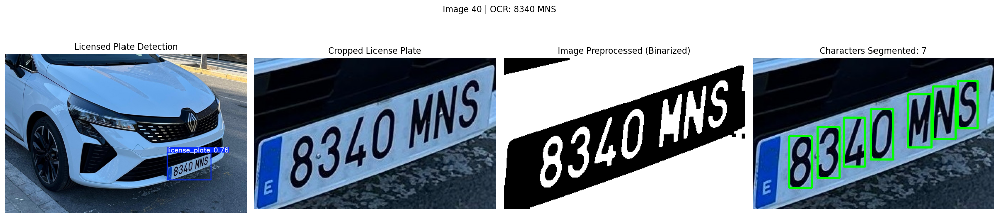


--- Processing Image 41 ---
Detected License Plate 1: Bbox (172, 633, 609, 904)
Found 7 character candidates.
OCR Result, Detected Plate: 8577 MPX


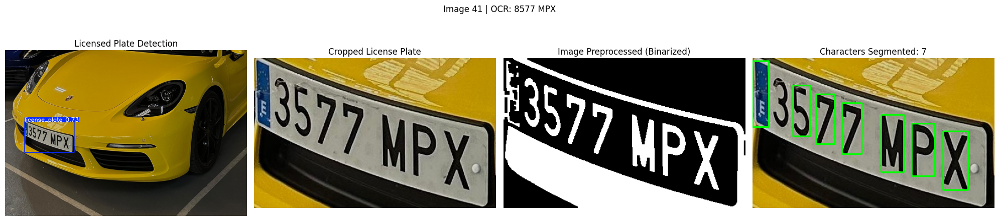


--- Processing Image 42 ---
Detected License Plate 1: Bbox (110, 272, 289, 373)
Found 6 character candidates.
OCR Result, Detected Plate: 9885 MRK


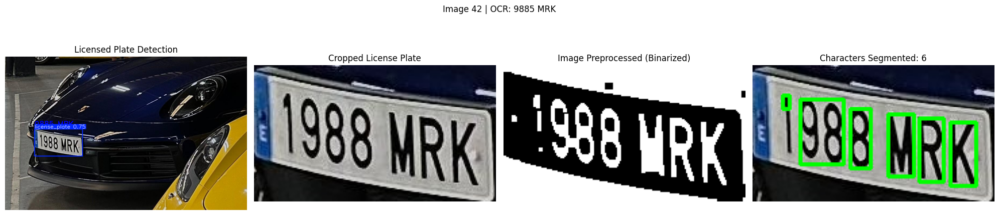


--- Processing Image 43 ---
Detected License Plate 1: Bbox (1592, 920, 1838, 1138)
Found 7 character candidates.
OCR Result, Detected Plate: 1281 MFN


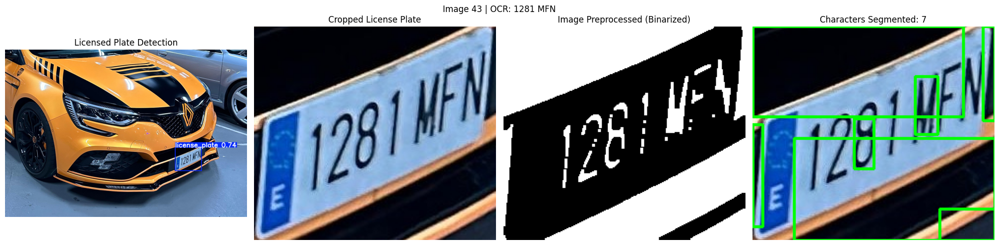


--- Processing Image 44 ---
Detected License Plate 1: Bbox (353, 715, 740, 957)
Found 7 character candidates.
OCR Result, Detected Plate: 5599 KGS


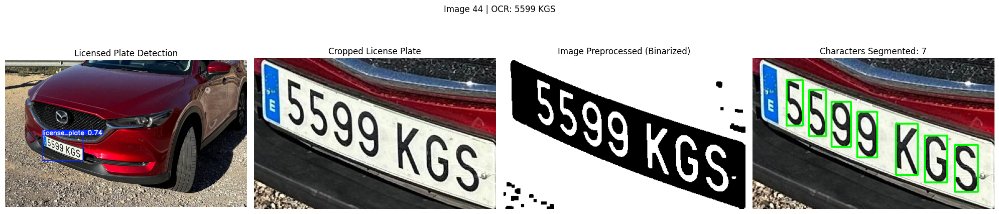


--- Processing Image 45 ---
Detected License Plate 1: Bbox (972, 304, 1289, 423)
Found 7 character candidates.
OCR Result, Detected Plate: 2994 GXT


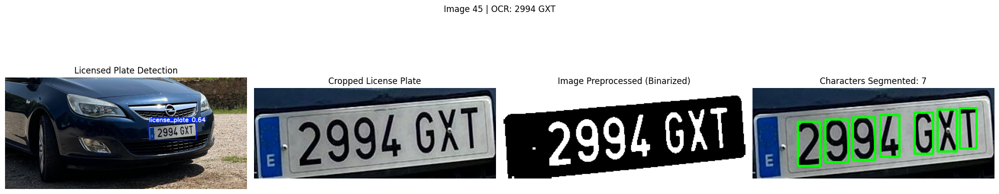


--- Processing Image 46 ---
Detected License Plate 1: Bbox (334, 497, 691, 658)
Found 7 character candidates.
OCR Result, Detected Plate: 5511 LMY


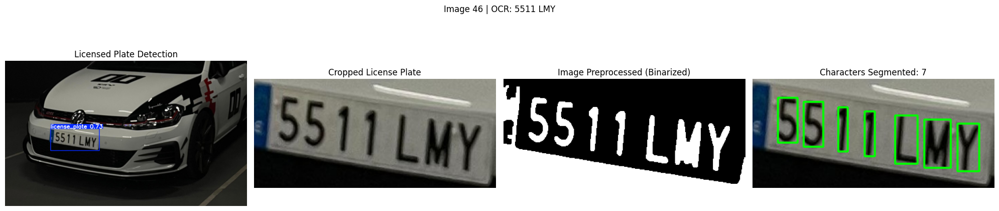


--- Processing Image 47 ---
Detected License Plate 1: Bbox (473, 1393, 917, 1761)
Found 7 character candidates.
OCR Result, Detected Plate: QL56


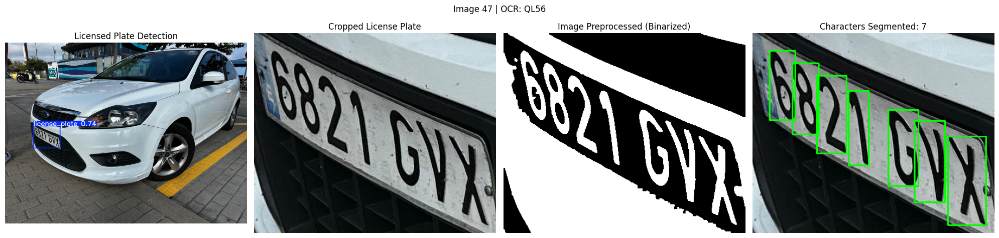


--- Processing Image 48 ---
Detected License Plate 1: Bbox (2371, 1477, 3153, 1933)
Found 7 character candidates.
OCR Result, Detected Plate: 0191 GNL


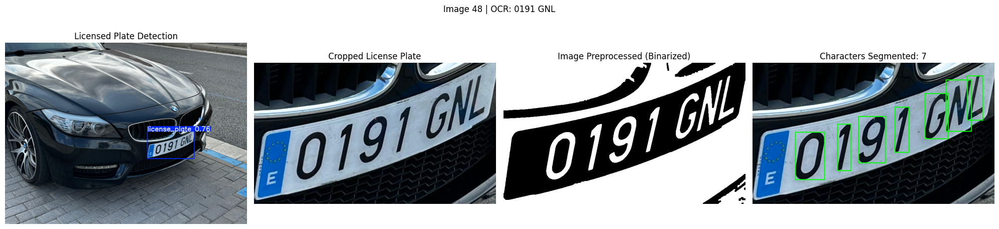


--- Processing Image 49 ---
Detected License Plate 1: Bbox (1933, 1139, 2657, 1527)
Found 7 character candidates.
OCR Result, Detected Plate: 2889 KXK


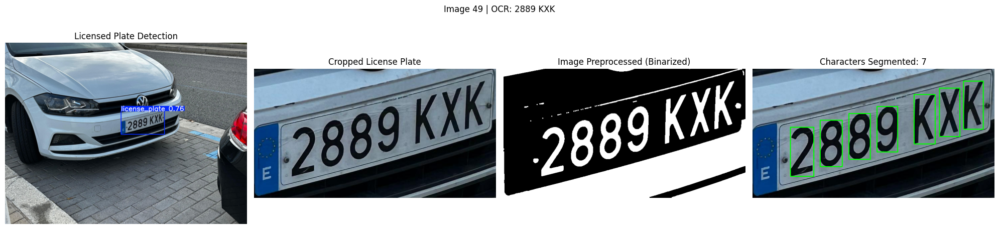

In [48]:
# Segmentation and display of characters

detector.process_and_show_results(prediction_results, reader)